<span style="color: #03FFFF; font-family: Times New Roman; font-size: 2em;"> Attention Maps </span> <br>
This notebook shows to visualize the attention maps and shows exampels aof self- and cross-attentions and making gifs over timesteps.

In [1]:
%cd ..
from main import load, run
from interventions.ablate import AblationIntervention
from interventions.encoder import EncoderIntervention
from interventions.scale import ScalingIntervention
from util import encode_prompt
import matplotlib.pyplot as plt
import torch
import numpy as np

/share/u/imgr/nnsight-folder/collaborative_diffusion


In [2]:
model = load()
model._model.pipeline.safety_checker = None

Keyword arguments {'trust_remote_code': True} are not expected by StableDiffusionPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

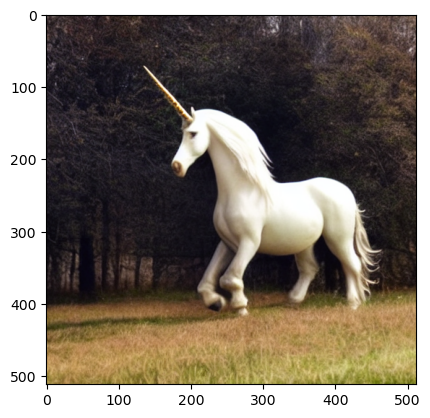

In [3]:
image = run(model, prompt="unicorn", seed=79)
plt.imshow(image)

In [4]:
unicorn_story = "In the serene meadows of Enchantia, where the morning dew danced with the dawn's light, lived a creature of pure magic and wonder—the unicorn. With a coat as iridescent as moonlight and eyes that held the secrets of the cosmos, it roamed freely, its graceful strides leaving shimmering trails of stardust. Legends whispered of its healing touch and its ability to reveal ones truest desires. Yet, amidst the whispers, the unicorn remained elusive, a symbol of hope and purity in a world yearning for magic. For those fortunate enough to glimpse it, their hearts forever carried the enchantment of Enchantia."

<span style="color: #FF4FA7; font-family: Times New Roman; font-size: 2em;">Extracting the attention maps for each timestep</span>
<span style="color: #03FFFF; font-family: Times New Roman; font-size: 1em;">  <br> 1. make envoys of attentions at target layer <br> 2. trace k and q at each timestep + compute attn-map <br> 3. append to list of maps <br> There are 16 attention maps - 8 for the conditional and 8 for the unconditional image.</span>

In [11]:
seed = 79
generator = torch.Generator()
generator = generator.manual_seed(seed)

with model.generate("unicorn", generator=generator, scan=False, validate=False) as tracer:
    #choose target attentions at layer : attn1 is self-attention, att2 is cross-attentions
    #attn = model.unet.mid_block.attentions[0].transformer_blocks[0].attn2
    #attn = model.unet.down_blocks[1].attentions[0].transformer_blocks[0].attn2
    attn = model.unet.up_blocks[1].attentions[1].transformer_blocks[0].attn2
    
    # q_list = []
    # k_list = []
    maps = []

    for i in range(25):
        if i != 0:
            attn.next(propagate=True)
        q = attn.to_q.output.cpu()
        k = attn.to_k.output.cpu()

        q = tracer.apply(attn.head_to_batch_dim, False, q)
        k = tracer.apply(attn.head_to_batch_dim, False, k)

        attn_probs = tracer.apply(attn.get_attention_scores, False, q, k).save()

        maps.append(attn_probs)

maps = torch.stack(maps)
print(maps.shape)

  0%|          | 0/50 [00:00<?, ?it/s]

torch.Size([25, 16, 256, 77])


For the 50 timesteps, there are 16 attention maps, one for each head - the first 8 are for the unconditional and 8 for the conditional image.<br>
Self-attention maps have the shape of the patches x patches, cross-attention maps are patches x 77 tokens, as seen here for one of the images and its 8 heads. <br>

<span style="color: #03FFFF; font-family: Times New Roman; font-size: 2em;"> Cross-attention maps </span>

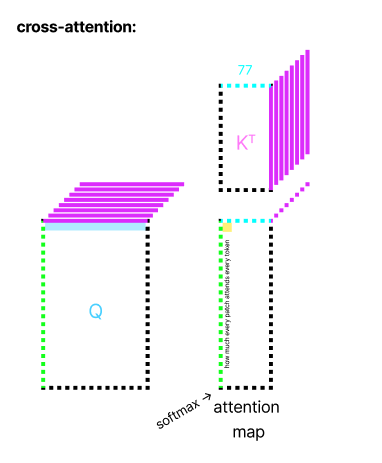

In [12]:
#To plot in activations in same scale for comparison across maps.
activation_avg = maps.cpu().mean().item()
activation_min = maps.cpu().min().item()
activation_max = maps.cpu().max().item()

print (f"Average activation: {activation_avg}")
print (f"Minimum activation: {activation_min}")
print (f"Maximum activation: {activation_max}")

Average activation: 0.012987012974917889
Minimum activation: 2.4218904215445036e-08
Maximum activation: 0.9999927282333374


Plotting attention maps for one of the timesteps <br>

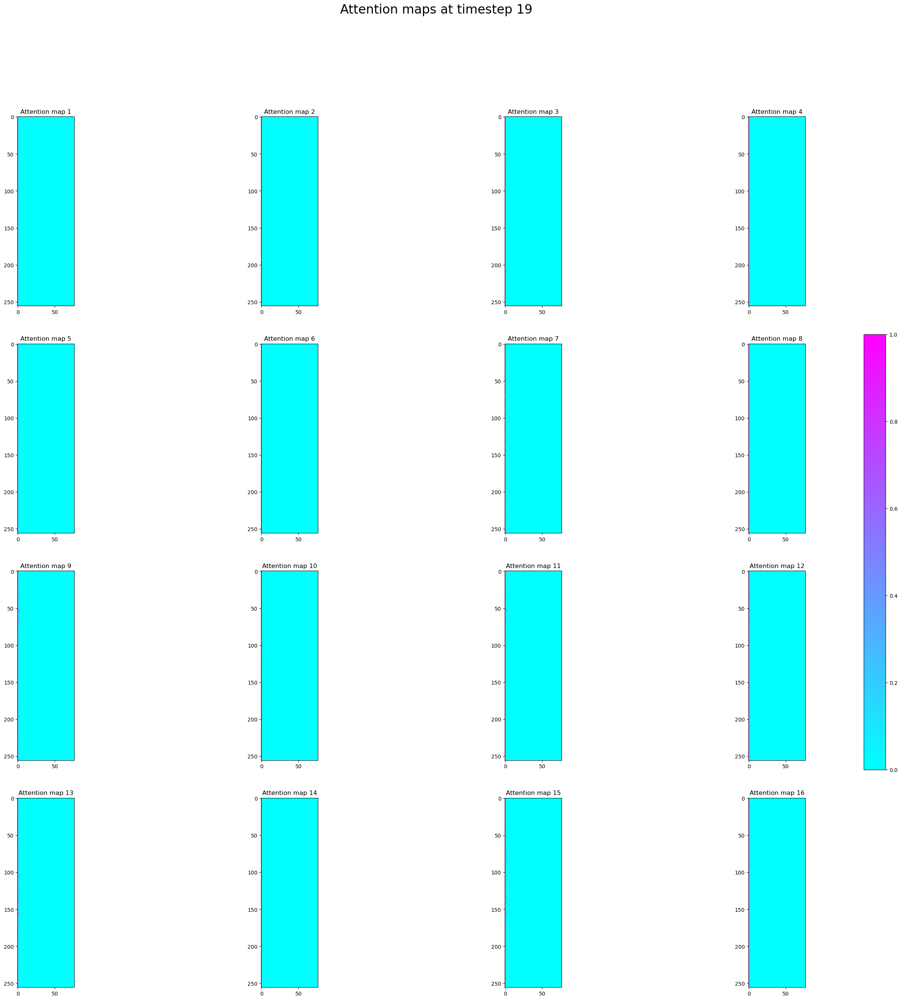

In [13]:
t = 19

fig, axes = plt.subplots(4, 4, figsize=(40,30), dpi=100)

for i, ax in enumerate(axes.flat):
    im = ax.imshow(maps.cpu()[t][i], cmap='cool', vmin=0, vmax = 1)
    ax.set_title(f"Attention map {i+1}")

plt.colorbar(im, ax=axes.ravel().tolist(), shrink=.5)

fig.suptitle(f"Attention maps at timestep {t}", fontsize=24)
plt.show()

Plot sum over all timesteps

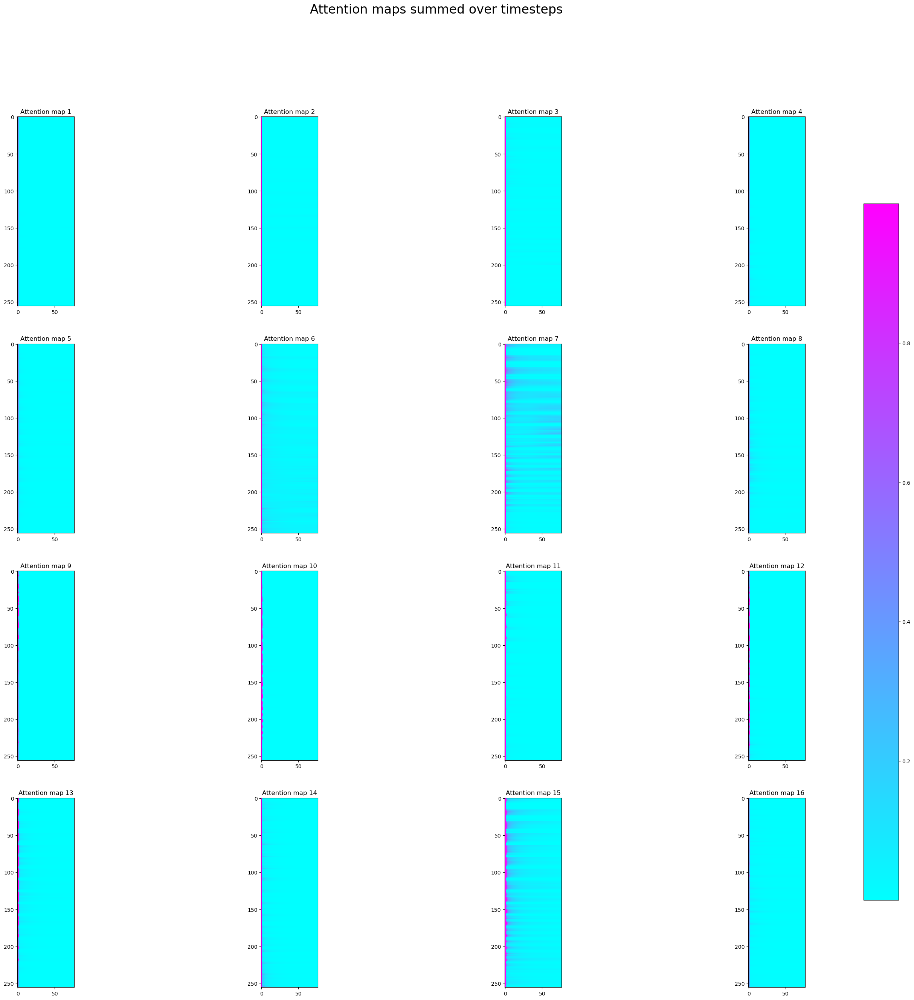

In [10]:
sum_maps = maps.sum(dim=0)

fig, axes = plt.subplots(4, 4, figsize=(40,30), dpi=100)

for i, ax in enumerate(axes.flat):
    im = ax.imshow(sum_maps.cpu()[i], cmap='cool', vmin=activation_min, vmax = activation_max)
    ax.set_title(f"Attention map {i+1}")

plt.colorbar(im, ax=axes.ravel().tolist(), shrink=.8)

fig.suptitle(f"Attention maps summed over timesteps", fontsize=24)
plt.show()

<span style="color: #03FFFF; font-family: Times New Roman; font-size: 2em;"> Self-attention maps </span>

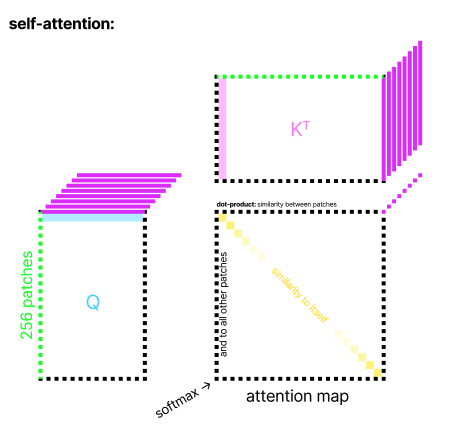

In [15]:
seed = 79
generator = torch.Generator()
generator = generator.manual_seed(seed)

with model.generate("unicorn", generator=generator, scan=False, validate=False) as tracer:
    #choose target attentions at layer : attn1 is self-attention, att2 is cross-attentions
    #attn = model.unet.mid_block.attentions[0].transformer_blocks[0].attn1
    #attn = model.unet.down_blocks[1].attentions[0].transformer_blocks[0].attn1 
    attn = model.unet.up_blocks[1].attentions[1].transformer_blocks[0].attn1
    
    # q_list = []
    # k_list = []
    maps = []

    for i in range(25):
        if i != 0:
            attn.next(propagate=True)
        q = attn.to_q.output.cpu()
        k = attn.to_k.output.cpu()

        q = tracer.apply(attn.head_to_batch_dim, False, q)
        k = tracer.apply(attn.head_to_batch_dim, False, k)

        attn_probs = tracer.apply(attn.get_attention_scores, False, q, k).save()

        maps.append(attn_probs)

maps = torch.stack(maps)
print(maps.shape)

  0%|          | 0/50 [00:00<?, ?it/s]

torch.Size([25, 16, 256, 256])


In [16]:
#To plot in activations in same scale for comparison across maps.
activation_avg = maps.cpu().mean().item()
activation_min = maps.cpu().min().item()
activation_max = maps.cpu().max().item()

print (f"Average activation: {activation_avg}")
print (f"Minimum activation: {activation_min}")
print (f"Maximum activation: {activation_max}")

Average activation: 0.00390625
Minimum activation: 2.954022443324433e-11
Maximum activation: 0.8899818062782288


Plot for one of the timesteps:

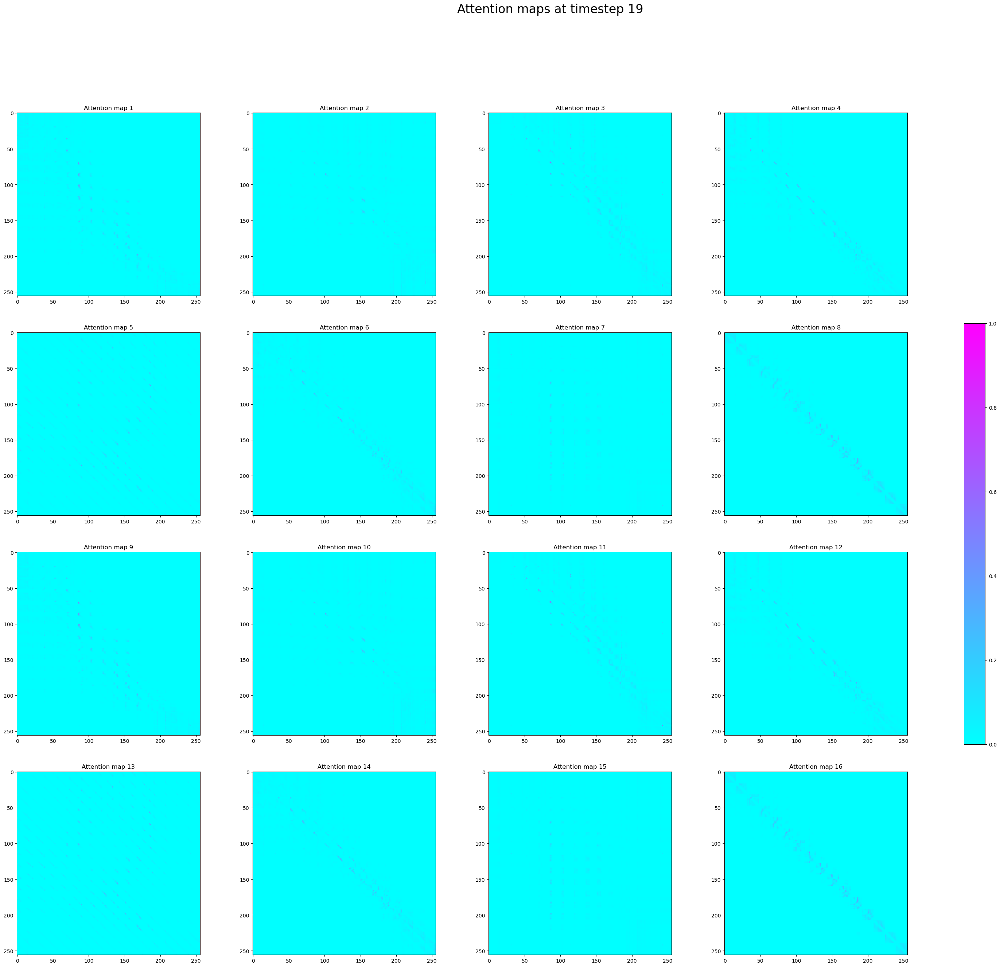

In [17]:
t = 19

fig, axes = plt.subplots(4, 4, figsize=(40,30), dpi=100)

for i, ax in enumerate(axes.flat):
    im = ax.imshow(maps.cpu()[t][i], cmap='cool', vmin=0, vmax = 1)
    ax.set_title(f"Attention map {i+1}")

plt.colorbar(im, ax=axes.ravel().tolist(), shrink=.5)

fig.suptitle(f"Attention maps at timestep {t}", fontsize=24)
plt.show()

Plot sum over all timesteps

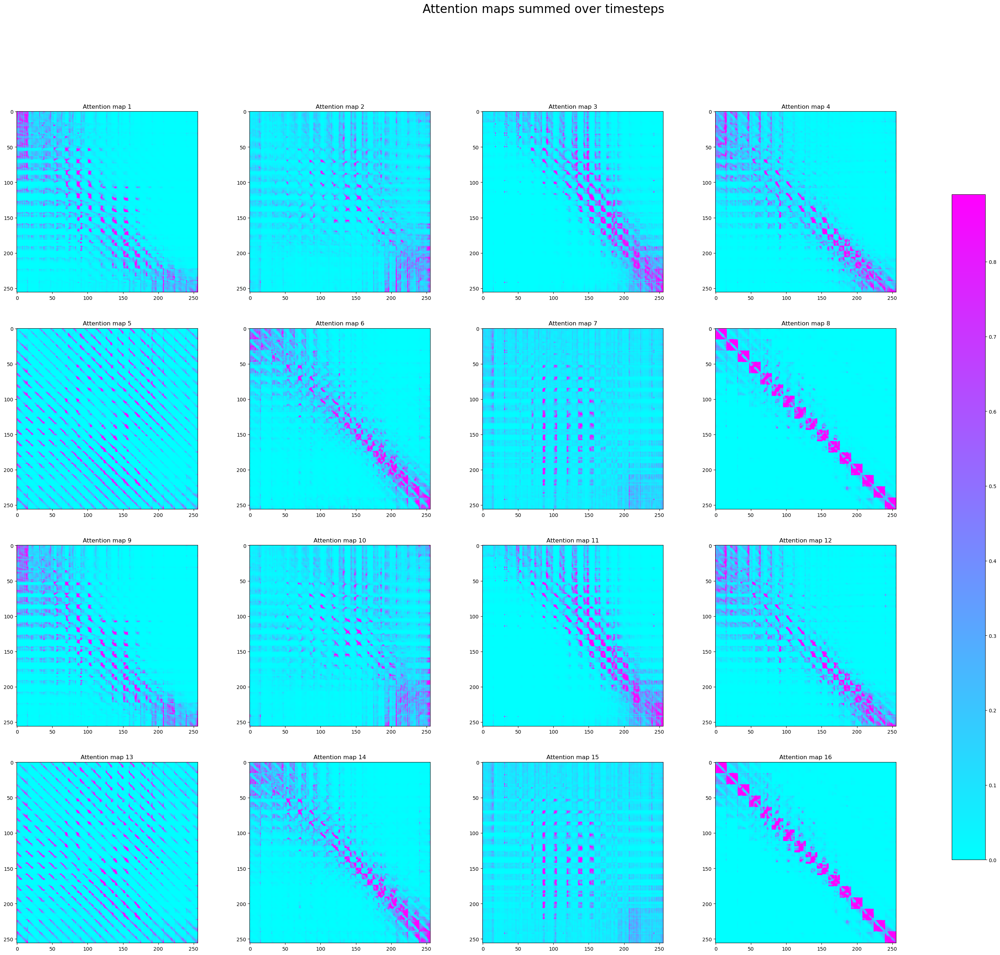

In [18]:
sum_maps = maps.sum(dim=0)

fig, axes = plt.subplots(4, 4, figsize=(40,30), dpi=100)

for i, ax in enumerate(axes.flat):
    im = ax.imshow(sum_maps.cpu()[i], cmap='cool', vmin=activation_min, vmax = activation_max)
    ax.set_title(f"Attention map {i+1}")

plt.colorbar(im, ax=axes.ravel().tolist(), shrink=.8)

fig.suptitle(f"Attention maps summed over timesteps", fontsize=24)
plt.show()

<span style="color: #03FFFF; font-family: Times New Roman; font-size: 2em;"> Making a gif over timesteps </span>

In [ ]:
for t in range(50):
    plt.figure(figsize=(10, 40), dpi=100)
    plt.title(f"timestep {t}")
    plt.axis("off")
    for i in range(8):
        plt.subplot(8, 1, i+1)
        plt.imshow(maps.cpu()[t][i], cmap='cool')#, interpolation='nearest')
    plt.savefig(f"image-outputs/attn-maps/blue-elephant-40/layer7_a-{t}.png")
        #plt.colorbar()
    plt.clf()
    plt.close()
    #plt.show()

In [68]:
import imageio.v3 as iio

images = []

for t in range(50):
  images.append(iio.imread(f"image-outputs/attn-maps/blue-elephant-40/layer7_a-{t}.png"))

iio.imwrite('image-outputs/attn-maps/blue-elephant-40/layer7_a.gif', images, duration = 500, loop = 0) #each img in millisecs

<span style="color: #FF4FA7; font-family: Times New Roman; font-size: 2em;">Inspecting a single attention map</span>
<span style="color: #03FFFF; font-family: Times New Roman; font-size: 1em;">  <br> To see the details in the higher resolution layer's attention maps </span>


In [55]:
plt.figure(figsize=(100, 100), dpi=100)

plt.imshow(maps.cpu()[0][3], cmap='cool')
plt.colorbar()
plt.title
plt.show()